In [24]:
# import libraries

import pandas as pd

import numpy as np

import re

import nltk

from nltk.corpus import stopwords

from tensorflow.keras.preprocessing.text import Tokenizer

from tensorflow.keras.preprocessing.sequence import pad_sequences

from tensorflow.keras.models import Sequential

from keras.layers import Dense, Embedding, LSTM, SpatialDropout1D, Dropout, Bidirectional, Concatenate, Input

from sklearn.model_selection import train_test_split

from keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau

from sklearn.metrics import classification_report

from tensorflow.keras.models import Model

from sklearn.preprocessing import OneHotEncoder

from sklearn.metrics import classification_report

from sklearn.metrics import accuracy_score

from sklearn.metrics import confusion_matrix

import seaborn as sns

import matplotlib.pyplot as plt

from sklearn.metrics import classification_report
from keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau

from sklearn.metrics import classification_report

from tensorflow.keras.models import Model

from sklearn.preprocessing import OneHotEncoder

from sklearn.metrics import classification_report

from sklearn.metrics import accuracy_score

from sklearn.metrics import confusion_matrix

import seaborn as sns

import matplotlib.pyplot as plt

from sklearn.metrics import classification_report

import plotly.graph_objs as go

import plotly.colors as colors

from keras.models import Model
from keras.layers import SimpleRNN, LSTM, Bidirectional, GRU
from keras.layers import Input, MultiHeadAttention, Attention, AdditiveAttention

from keras.layers import Embedding, Dense, Dropout, BatchNormalization
from keras.optimizers import Adam
from wordcloud import WordCloud

In [3]:
# read data

train = pd.read_csv('/kaggle/input/sentiment-analysis-dataset/train.csv', encoding='ISO-8859-1')

test = pd.read_csv('/kaggle/input/sentiment-analysis-dataset/test.csv', encoding='ISO-8859-1')

df = pd.DataFrame(train)

df_test = pd.DataFrame(test)

In [4]:
print(df.head())

       textID                                               text  \
0  cb774db0d1                I`d have responded, if I were going   
1  549e992a42      Sooo SAD I will miss you here in San Diego!!!   
2  088c60f138                          my boss is bullying me...   
3  9642c003ef                     what interview! leave me alone   
4  358bd9e861   Sons of ****, why couldn`t they put them on t...   

                         selected_text sentiment Time of Tweet Age of User  \
0  I`d have responded, if I were going   neutral       morning        0-20   
1                             Sooo SAD  negative          noon       21-30   
2                          bullying me  negative         night       31-45   
3                       leave me alone  negative       morning       46-60   
4                        Sons of ****,  negative          noon       60-70   

       Country  Population -2020  Land Area (Km²)  Density (P/Km²)  
0  Afghanistan          38928346         652860.0    

In [5]:
# remove unwanter columns

df.drop(['Density (P/Km²)', 'Land Area (Km²)', 'Population -2020', 'Age of User', 'Time of Tweet', 'selected_text', 'Country', 'textID'], axis=1, inplace=True)

df_test.drop(['Density (P/Km²)', 'Land Area (Km²)', 'Population -2020', 'Age of User', 'Time of Tweet', 'Country'], axis=1, inplace=True)

In [6]:
print(df.head())

                                                text sentiment
0                I`d have responded, if I were going   neutral
1      Sooo SAD I will miss you here in San Diego!!!  negative
2                          my boss is bullying me...  negative
3                     what interview! leave me alone  negative
4   Sons of ****, why couldn`t they put them on t...  negative


In [7]:
# cleaning data

nltk.download('stopwords')

stop_words = set(stopwords.words('english'))



df.dropna(inplace=True)

df_test.dropna(inplace=True)



def preprocess_text(text):

    if not isinstance(text, str):

        return ''

    text = re.sub(r'[^a-zA-Z\s]', '', text)

    text = text.lower()

    tokens = [word for word in text.split() if word not in stop_words]

    return ' '.join(tokens)



# Ensure the 'text' column is of string type

df['text'] = df['text'].astype(str)

df_test['text'] = df_test['text'].astype(str)



df['text'] = df['text'].apply(preprocess_text)

df_test['text'] = df_test['text'].apply(preprocess_text)


[nltk_data] Downloading package stopwords to /usr/share/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [8]:
print(df.head())

                                       text sentiment
0                        id responded going   neutral
1                   sooo sad miss san diego  negative
2                             boss bullying  negative
3                     interview leave alone  negative
4  sons couldnt put releases already bought  negative


### Data Visualization

In [9]:
# Visualize Data
cyberpunk_palette = ["#FF00FF", "#00FF00", "#0000FF"]
template = "plotly_dark"

In [12]:
# Word Length Distribution
word_lengths = [len(word) for text in df['text'] for word in text.split()]
word_lengths_counts = {length: word_lengths.count(length) for length in set(word_lengths)}

# Sort the word lengths by count in descending order
sorted_word_lengths = sorted(word_lengths_counts.items(), key=lambda x: x[1], reverse=True)

# Create a custom colorscale with a fixed number of colors
colorscale = colors.sample_colorscale('Viridis', len(word_lengths_counts))

# Create the bar chart trace
bar_trace = go.Bar(
    x=[length for length, count in sorted_word_lengths],
    y=[count for length, count in sorted_word_lengths],
    marker=dict(
        color=[colorscale[i] for i in range(len(sorted_word_lengths))],
        line=dict(
            color=cyberpunk_palette[0],
            width=2
        )
    ),
    hovertemplate='Word Length: %{x}<br>Count: %{y}<extra></extra>'
)

# Create the neon light effect trace
light_effect_trace = go.Scatter(
    x=[length for length, count in sorted_word_lengths],
    y=[count * 1.05 for length, count in sorted_word_lengths],
    mode='lines',
    line=dict(
        color=cyberpunk_palette[1],
        width=5
    ),
    hoverinfo='skip'
)

# Create the layout
layout = go.Layout(
    title="Word Length Distribution",
    xaxis=dict(
        title="Word Length",
        tickfont=dict(color=cyberpunk_palette[2])
    ),
    yaxis=dict(
        title="Count",
        tickfont=dict(color=cyberpunk_palette[2])
    ),
    plot_bgcolor="black",
    paper_bgcolor="black",
    font_color=cyberpunk_palette[2],
    title_font_color=cyberpunk_palette[2],
    title_font_size=20,
    margin=dict(t=80, l=100, r=50, b=100)
)

# Create the figure and show it
fig = go.Figure(data=[bar_trace, light_effect_trace], layout=layout)
fig.show()

In [13]:
# Sentence Length Distribution
sentence_lengths = [len(text.split()) for text in df['text']]

# Create a custom colorscale with a fixed number of colors
colorscale = colors.sample_colorscale('Viridis', len(set(sentence_lengths)))

bar_trace = go.Bar(
    x=sorted(set(sentence_lengths)),
    y=[sentence_lengths.count(length) for length in sorted(set(sentence_lengths))],
    marker=dict(
        color=[colorscale[i] for i in range(len(set(sentence_lengths)))],
        line=dict(
            color=cyberpunk_palette[0],
            width=2
        )
    ),
    hovertemplate='Sentence Length: %{x}<br>Count: %{y}<extra></extra>'
)

light_effect_trace = go.Scatter(
    x=sorted(set(sentence_lengths)),
    y=[sentence_lengths.count(length) * 1.05 for length in sorted(set(sentence_lengths))],
    mode='lines',
    line=dict(
        color=cyberpunk_palette[1],
        width=5
    ),
    hoverinfo='skip'
)

layout = go.Layout(
    title="Sentence Length Distribution",
    xaxis=dict(
        title="Sentence Length",
        tickfont=dict(color=cyberpunk_palette[2])
    ),
    yaxis=dict(
        title="Count",
        tickfont=dict(color=cyberpunk_palette[2])
    ),
    plot_bgcolor="black",
    paper_bgcolor="black",
    font_color=cyberpunk_palette[2],
    title_font_color=cyberpunk_palette[2],
    title_font_size=20,
    margin=dict(t=80, l=100, r=50, b=100)
)

fig = go.Figure(data=[bar_trace, light_effect_trace], layout=layout)
fig.show()


In [15]:
# Word Cloud for Positive Sentiment
positive_text = ' '.join(df[df['sentiment'] == 'positive']['text'])
wordcloud = WordCloud(background_color='black', width = 800, height = 400, max_words=200, colormap='Greens').generate(positive_text)
fig = go.Figure(go.Image(z = np.dstack((wordcloud.to_array(), wordcloud.to_array(), wordcloud.to_array()))))
fig.update_layout(
    title = 'Word Cloud For Positive Sentiment',
    template = template,
    plot_bgcolor = 'black',
    paper_bgcolor = 'black',
    font_color = cyberpunk_palette[2],
    title_font_color = cyberpunk_palette[2],
    title_font_size = 20,
    margin = dict(t = 80, l = 50, r = 50, b = 50)
)
fig.show()

In [16]:
# Word Cloud for Negative Sentiment
negative_text = ' '.join(df[df['sentiment'] == 'negative']['text'])
wordcloud = WordCloud(background_color='black', width=800, height=400, max_words=200, colormap='Reds').generate(negative_text)
fig = go.Figure(go.Image(z=np.dstack((wordcloud.to_array(), wordcloud.to_array(), wordcloud.to_array()))))
fig.update_layout(
    title="Word Cloud for Negative Sentiment",
    template=template,
    plot_bgcolor="black",
    paper_bgcolor="black",
    font_color=cyberpunk_palette[2],
    title_font_color=cyberpunk_palette[2],
    title_font_size=20,
    margin=dict(t=80, l=50, r=50, b=50)
)
fig.show()

In [17]:
# Word Cloud for Neutral Sentiment
neutral_text = ' '.join(df[df['sentiment'] == 'neutral']['text'])
wordcloud = WordCloud(background_color='black', width=800, height=400, max_words=200, colormap='Blues').generate(neutral_text)
fig = go.Figure(go.Image(z=np.dstack((wordcloud.to_array(), wordcloud.to_array(), wordcloud.to_array()))))
fig.update_layout(
    title="Word Cloud for Neutral Sentiment",
    template=template,
    plot_bgcolor="black",
    paper_bgcolor="black",
    font_color=cyberpunk_palette[2],
    title_font_color=cyberpunk_palette[2],
    title_font_size=20,
    margin=dict(t=80, l=50, r=50, b=50)
)
fig.show()

In [25]:
# tokenization

tokenizer = Tokenizer(num_words=2000)

tokenizer.fit_on_texts(df['text'].values)

X = tokenizer.texts_to_sequences(df['text'])

X = pad_sequences(X, maxlen=100)

y = pd.get_dummies(df['sentiment']).values



tokenizer.fit_on_texts(df_test['text'])

X_test_data = tokenizer.texts_to_sequences(df_test['text'])

X_test_data = pad_sequences(X_test_data, maxlen=100)

y_test_data = pd.get_dummies(df_test['sentiment']).values

In [26]:
def create_model(model_type, vocab_size, embedding_dim, num_classes=3):
    model = Sequential()
    model.add(Embedding(vocab_size, embedding_dim))

    if model_type == 'RNN':
        model.add(SimpleRNN(32, return_sequences=True))
    elif model_type == 'LSTM':
        model.add(LSTM(32, return_sequences=True))
    elif model_type == 'GRU':
        model.add(GRU(32, return_sequences=True))
    elif model_type == 'BiLSTM':
        model.add(Bidirectional(LSTM(32, return_sequences=True)))
    elif model_type == 'BiGRU':
        model.add(Bidirectional(GRU(32, return_sequences=True)))
    else:
        raise ValueError("Invalid model type. Choose from 'RNN', 'LSTM', 'GRU', 'BiLSTM', 'BiGRU'.")

    model.add(BatchNormalization())

    if model_type == 'RNN':
        model.add(SimpleRNN(64))
    elif model_type == 'LSTM':
        model.add(LSTM(64))
    elif model_type == 'GRU':
        model.add(GRU(64))
    elif model_type == 'BiLSTM':
        model.add(Bidirectional(LSTM(64)))
    elif model_type == 'BiGRU':
        model.add(Bidirectional(GRU(64)))

    model.add(BatchNormalization())
    model.add(Dense(64, activation='relu'))
    # model.add(Dropout(0.2)) # coba tanpa dropout
    model.add(Dense(num_classes, activation='softmax'))

    model.compile(loss='categorical_crossentropy', optimizer=Adam(), metrics=['accuracy'])
    return model

Training RNN model...
859/859 ━━━━━━━━━━━━━━━━━━━━ 24s 22ms/step - accuracy: 0.5241 - loss: 0.9753 - val_accuracy: 0.4420 - val_loss: 1.2861
111/111 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
              precision    recall  f1-score   support

           0       0.57      0.15      0.23      1001
           1       0.42      0.93      0.58      1430
           2       0.79      0.07      0.14      1103

    accuracy                           0.44      3534
   macro avg       0.59      0.38      0.32      3534
weighted avg       0.58      0.44      0.34      3534



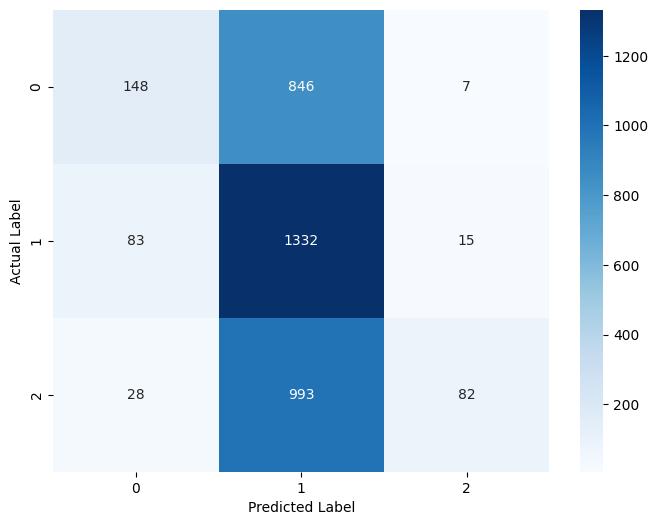

Training LSTM model...
859/859 ━━━━━━━━━━━━━━━━━━━━ 18s 17ms/step - accuracy: 0.5827 - loss: 0.8956 - val_accuracy: 0.4924 - val_loss: 1.1883
111/111 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
              precision    recall  f1-score   support

           0       0.49      0.22      0.31      1001
           1       0.52      0.54      0.53      1430
           2       0.47      0.67      0.55      1103

    accuracy                           0.49      3534
   macro avg       0.49      0.48      0.46      3534
weighted avg       0.50      0.49      0.47      3534



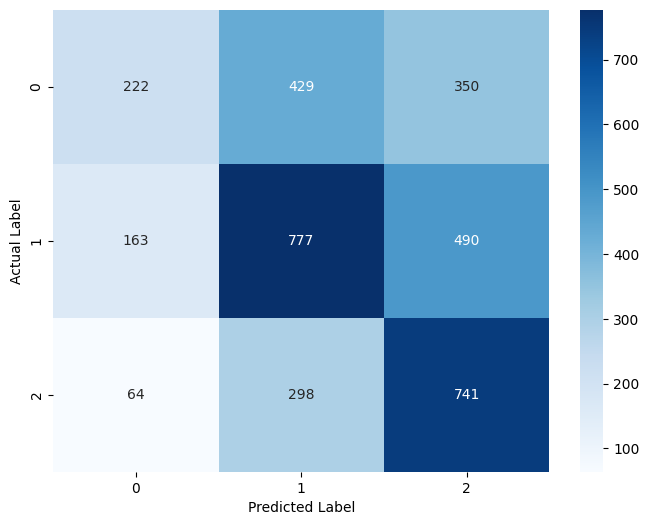

Training BiLSTM model...
859/859 ━━━━━━━━━━━━━━━━━━━━ 27s 26ms/step - accuracy: 0.5941 - loss: 0.8747 - val_accuracy: 0.4018 - val_loss: 1.4169
111/111 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
              precision    recall  f1-score   support

           0       0.35      0.64      0.45      1001
           1       0.41      0.01      0.03      1430
           2       0.46      0.69      0.55      1103

    accuracy                           0.40      3534
   macro avg       0.41      0.45      0.34      3534
weighted avg       0.41      0.40      0.31      3534



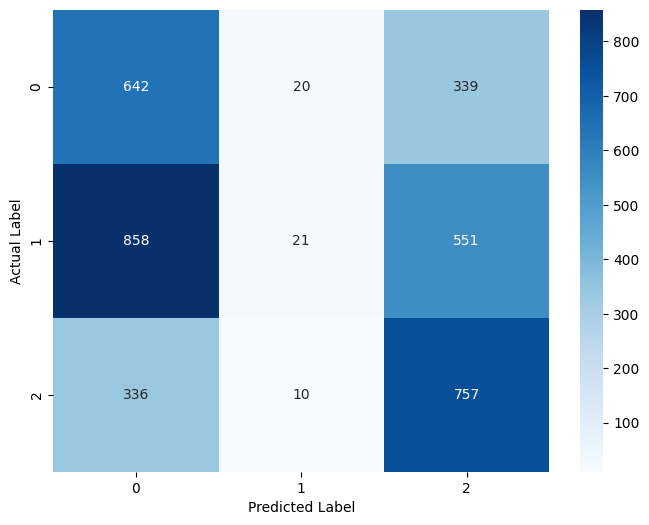

Training GRU model...
859/859 ━━━━━━━━━━━━━━━━━━━━ 19s 17ms/step - accuracy: 0.5902 - loss: 0.8839 - val_accuracy: 0.5173 - val_loss: 1.1192
111/111 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
              precision    recall  f1-score   support

           0       0.47      0.29      0.36      1001
           1       0.51      0.65      0.57      1430
           2       0.56      0.55      0.55      1103

    accuracy                           0.52      3534
   macro avg       0.51      0.50      0.50      3534
weighted avg       0.51      0.52      0.51      3534



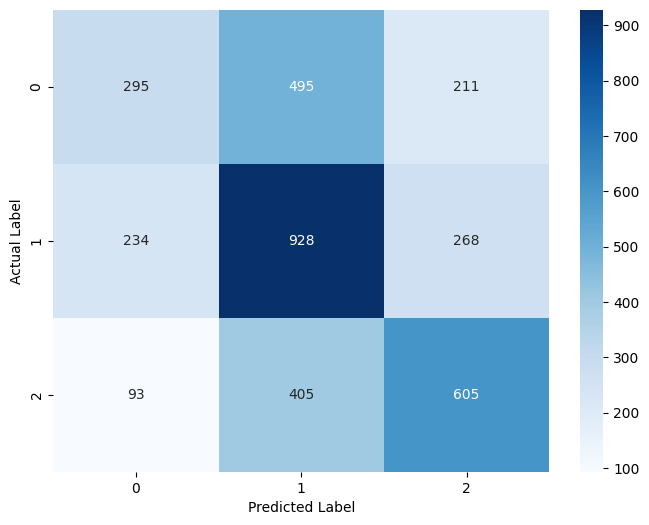

Training BiGRU model...
859/859 ━━━━━━━━━━━━━━━━━━━━ 26s 25ms/step - accuracy: 0.5932 - loss: 0.8741 - val_accuracy: 0.4046 - val_loss: 5.7717
111/111 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
              precision    recall  f1-score   support

           0       0.00      0.00      0.00      1001
           1       0.40      1.00      0.58      1430
           2       0.00      0.00      0.00      1103

    accuracy                           0.40      3534
   macro avg       0.13      0.33      0.19      3534
weighted avg       0.16      0.40      0.23      3534



/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



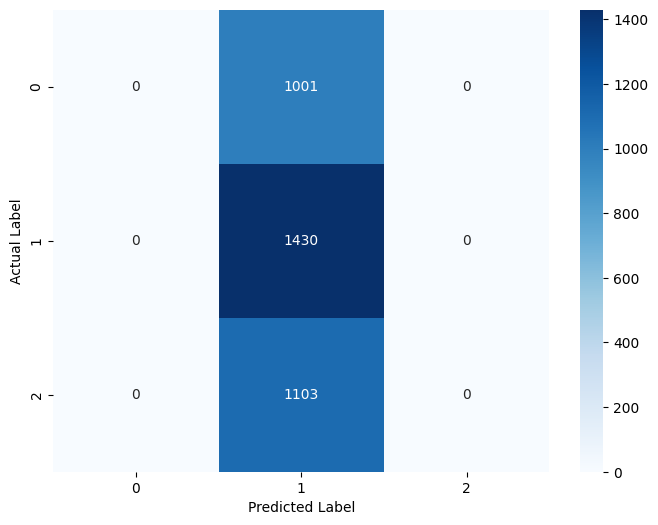

In [31]:
model_types = ['RNN', 'LSTM', 'BiLSTM', 'GRU', 'BiGRU']
vocab_size = len(tokenizer.word_index) + 1
embedding_dim = 128
num_classes = 3

for model_type in model_types:
    print(f"Training {model_type} model...")
    model = create_model(model_type, vocab_size, embedding_dim, num_classes)
    history= model.fit(X, y, epochs=1, validation_data=(X_test_data, y_test_data))
    y_pred = model.predict(X_test_data)
    y_pred_class = np.argmax(y_pred, axis=1)
    y_true_class = np.argmax(y_test_data, axis=1)
    print(classification_report(y_true_class, y_pred_class))
    conf_matrix = confusion_matrix(y_true_class, y_pred_class)
    # Visualize the confusion matrix

    plt.figure(figsize=(8, 6))

    sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues")

    plt.ylabel('Actual Label')

    plt.xlabel('Predicted Label')

    plt.show()

In [33]:
def predict_sentiment(input_text, tokenizer, model, max_length):
    # Preprocess the input text
    input_sequence = tokenizer.texts_to_sequences([input_text])
    padded_input_sequence = pad_sequences(input_sequence, maxlen=max_length, padding='post')

    # Get the prediction
    prediction = model.predict(padded_input_sequence)

    # Convert the prediction to sentiment label
    sentiment_labels = ['Negative', 'Neutral', 'Positive']
    predicted_label_index = np.argmax(prediction)
    predicted_sentiment = sentiment_labels[predicted_label_index]

    return predicted_sentiment

In [34]:
# Examples sentences of each sentiment
for sentiment in df['sentiment'].unique():
  print(f">>>>>>>>>>>>>>>>>>> example sentences of {sentiment}")
  rows = df[df['sentiment'] == sentiment]
  print(rows[['text']].head(5))
  print("\n")

>>>>>>>>>>>>>>>>>>> example sentences of neutral
                                                 text
0                                  id responded going
5   httpwwwdothebouncycomsmf shameless plugging be...
7                                          soooo high
8                                                    
10  much love hopeful reckon chances minimal p im ...


>>>>>>>>>>>>>>>>>>> example sentences of negative
                                        text
1                    sooo sad miss san diego
2                              boss bullying
3                      interview leave alone
4   sons couldnt put releases already bought
12       sharpie running dangerously low ink


>>>>>>>>>>>>>>>>>>> example sentences of positive
                                                 text
6                       feedings baby fun smiles coos
9           journey wow u became cooler hehe possible
11    really really like song love story taylor swift
21  playing ghost online really inter

In [37]:
tokenizer = Tokenizer()
tokenizer.fit_on_texts(df['text'])
sequences = tokenizer.texts_to_sequences(df['text'])

In [38]:
# Padding the Sequences
max_length = max([len(seq) for seq in sequences])
padded_sequences = pad_sequences(sequences, maxlen = max_length, padding = 'post')

In [40]:
input_text = "im in va for the weekend my youngest son turns"
predicted_sentiment = predict_sentiment(input_text, tokenizer, model, max_length)
print("Predicted Sentiment:", predicted_sentiment)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Predicted Sentiment: Positive


### Attention Mechanism (Multithread, Self Attention)

In [42]:
def create_model(model_type, vocab_size, embedding_dim, num_classes=3, attention_type=None):
    inputs = Input(shape=(None,))
    x = Embedding(vocab_size, embedding_dim)(inputs)

    if model_type == 'RNN':
        x = SimpleRNN(32, return_sequences=True)(x)
    elif model_type == 'LSTM':
        x = LSTM(32, return_sequences=True)(x)
    elif model_type == 'GRU':
        x = GRU(32, return_sequences=True)(x)
    elif model_type == 'BiLSTM':
        x = Bidirectional(LSTM(32, return_sequences=True))(x)
    elif model_type == 'BiGRU':
        x = Bidirectional(GRU(32, return_sequences=True))(x)
    else:
        raise ValueError("Invalid model type. Choose from 'RNN', 'LSTM', 'GRU', 'BiLSTM', 'BiGRU'.")

    if attention_type == 'multihead':
        x = MultiHeadAttention(num_heads=2, key_dim=32)(x, x)
    elif attention_type == 'self':
        x = Attention()([x, x])
    elif attention_type == 'adaptive':
        x = AdditiveAttention()([x, x])

    x = BatchNormalization()(x)

    if model_type == 'RNN':
        x = SimpleRNN(64)(x)
    elif model_type == 'LSTM':
        x = LSTM(64)(x)
    elif model_type == 'GRU':
        x = GRU(64)(x)
    elif model_type == 'BiLSTM':
        x = Bidirectional(LSTM(64))(x)
    elif model_type == 'BiGRU':
        x = Bidirectional(GRU(64))(x)

    x = BatchNormalization()(x)
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.2)(x)
    outputs = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs, outputs)
    model.compile(loss='categorical_crossentropy', optimizer=Adam(), metrics=['accuracy'])
    return model

Training RNN model without attention...
859/859 ━━━━━━━━━━━━━━━━━━━━ 27s 24ms/step - accuracy: 0.5127 - loss: 1.0110 - val_accuracy: 0.3619 - val_loss: 1.8757 - learning_rate: 0.0010
859/859 ━━━━━━━━━━━━━━━━━━━━ 16s 19ms/step - accuracy: 0.7132 - loss: 0.6975 - val_accuracy: 0.3848 - val_loss: 1.6351
111/111 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
              precision    recall  f1-score   support

           0       0.52      0.14      0.22      1001
           1       0.42      0.18      0.25      1430
           2       0.36      0.88      0.51      1103

    accuracy                           0.38      3534
   macro avg       0.44      0.40      0.33      3534
weighted avg       0.43      0.38      0.32      3534



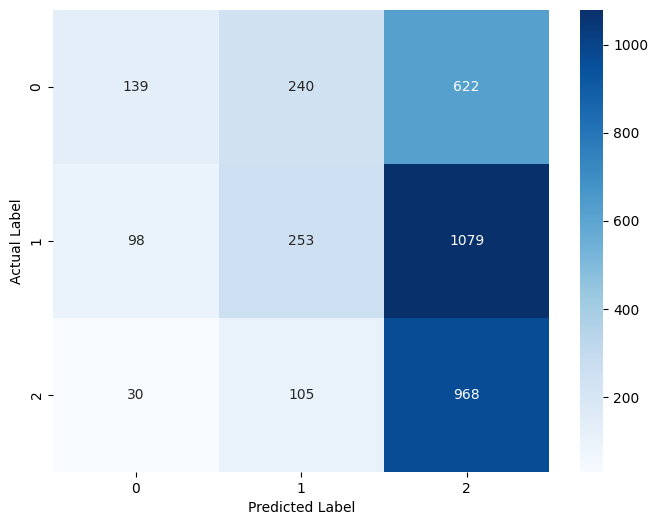

Training RNN model with multihead attention...
859/859 ━━━━━━━━━━━━━━━━━━━━ 27s 24ms/step - accuracy: 0.4843 - loss: 1.0472 - val_accuracy: 0.4559 - val_loss: 1.3230 - learning_rate: 0.0010
859/859 ━━━━━━━━━━━━━━━━━━━━ 16s 19ms/step - accuracy: 0.6971 - loss: 0.7191 - val_accuracy: 0.4825 - val_loss: 1.2740
111/111 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
              precision    recall  f1-score   support

           0       0.51      0.23      0.32      1001
           1       0.50      0.53      0.51      1430
           2       0.46      0.65      0.54      1103

    accuracy                           0.48      3534
   macro avg       0.49      0.47      0.46      3534
weighted avg       0.49      0.48      0.47      3534



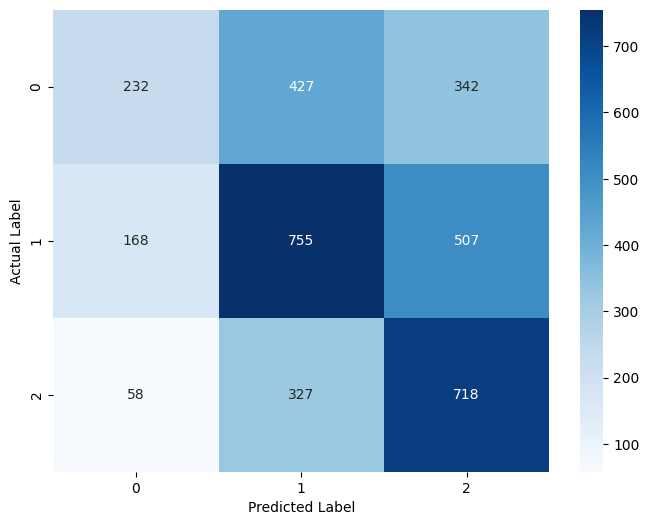

Training RNN model with self attention...
859/859 ━━━━━━━━━━━━━━━━━━━━ 26s 24ms/step - accuracy: 0.5154 - loss: 1.0130 - val_accuracy: 0.4397 - val_loss: 1.2635 - learning_rate: 0.0010
859/859 ━━━━━━━━━━━━━━━━━━━━ 16s 19ms/step - accuracy: 0.7039 - loss: 0.7126 - val_accuracy: 0.5156 - val_loss: 1.1306
111/111 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
              precision    recall  f1-score   support

           0       0.47      0.30      0.36      1001
           1       0.50      0.65      0.56      1430
           2       0.57      0.54      0.56      1103

    accuracy                           0.52      3534
   macro avg       0.51      0.50      0.49      3534
weighted avg       0.51      0.52      0.51      3534



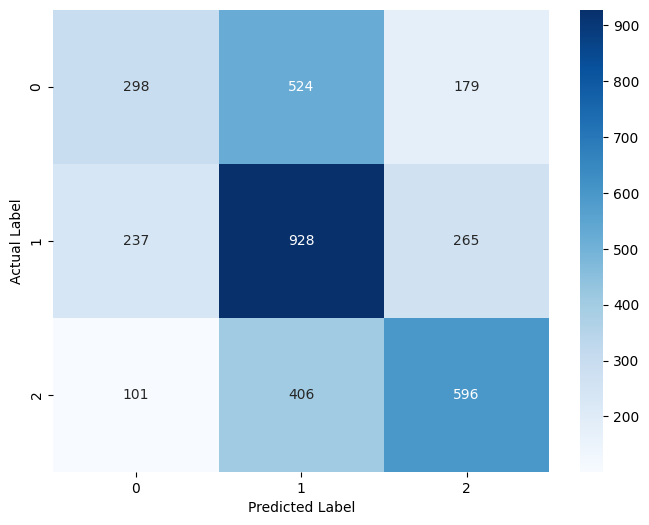

Training RNN model with adaptive attention...
859/859 ━━━━━━━━━━━━━━━━━━━━ 26s 24ms/step - accuracy: 0.5071 - loss: 1.0264 - val_accuracy: 0.5113 - val_loss: 1.0936 - learning_rate: 0.0010
859/859 ━━━━━━━━━━━━━━━━━━━━ 16s 19ms/step - accuracy: 0.7082 - loss: 0.7064 - val_accuracy: 0.5102 - val_loss: 1.1552
111/111 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
              precision    recall  f1-score   support

           0       0.45      0.34      0.39      1001
           1       0.49      0.67      0.57      1430
           2       0.61      0.46      0.53      1103

    accuracy                           0.51      3534
   macro avg       0.52      0.49      0.49      3534
weighted avg       0.52      0.51      0.50      3534



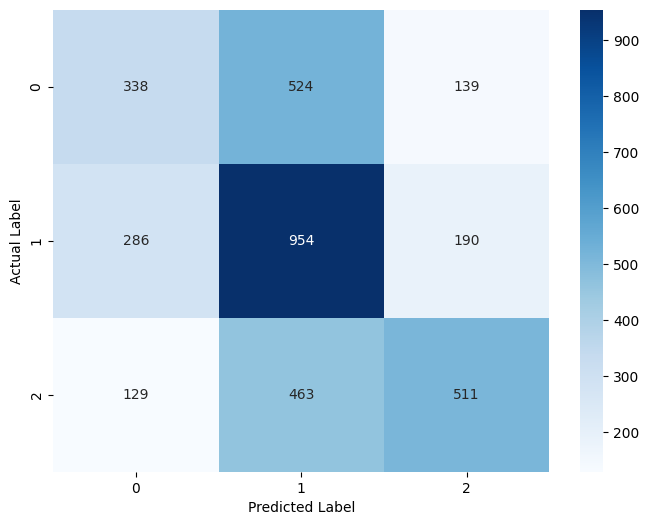

Training LSTM model without attention...
859/859 ━━━━━━━━━━━━━━━━━━━━ 19s 17ms/step - accuracy: 0.5806 - loss: 0.9063 - val_accuracy: 0.5082 - val_loss: 1.1432 - learning_rate: 0.0010
859/859 ━━━━━━━━━━━━━━━━━━━━ 14s 17ms/step - accuracy: 0.7296 - loss: 0.6701 - val_accuracy: 0.5042 - val_loss: 1.0781
111/111 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
              precision    recall  f1-score   support

           0       0.46      0.29      0.35      1001
           1       0.51      0.58      0.54      1430
           2       0.52      0.60      0.56      1103

    accuracy                           0.50      3534
   macro avg       0.50      0.49      0.48      3534
weighted avg       0.50      0.50      0.49      3534



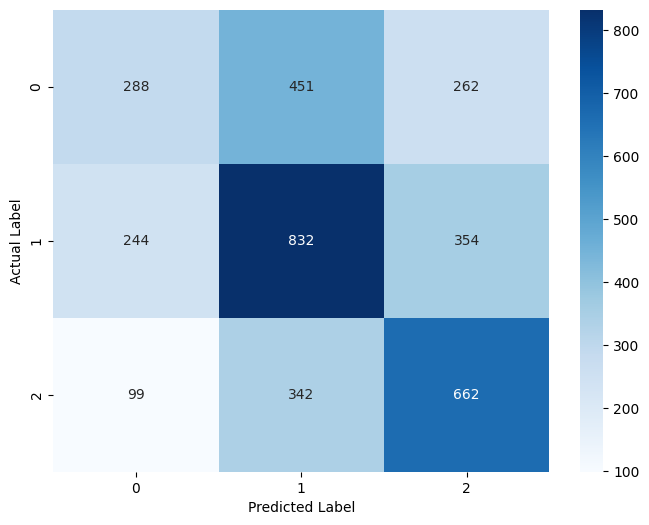

Training LSTM model with multihead attention...
859/859 ━━━━━━━━━━━━━━━━━━━━ 18s 17ms/step - accuracy: 0.5798 - loss: 0.9089 - val_accuracy: 0.5311 - val_loss: 1.0873 - learning_rate: 0.0010
859/859 ━━━━━━━━━━━━━━━━━━━━ 27s 26ms/step - accuracy: 0.5793 - loss: 0.9009 - val_accuracy: 0.4850 - val_loss: 2.4560 - learning_rate: 0.0010
859/859 ━━━━━━━━━━━━━━━━━━━━ 22s 25ms/step - accuracy: 0.7230 - loss: 0.6795 - val_accuracy: 0.5099 - val_loss: 1.3251
111/111 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
              precision    recall  f1-score   support

           0       0.53      0.13      0.21      1001
           1       0.49      0.71      0.58      1430
           2       0.54      0.60      0.57      1103

    accuracy                           0.51      3534
   macro avg       0.52      0.48      0.45      3534
weighted avg       0.52      0.51      0.47      3534



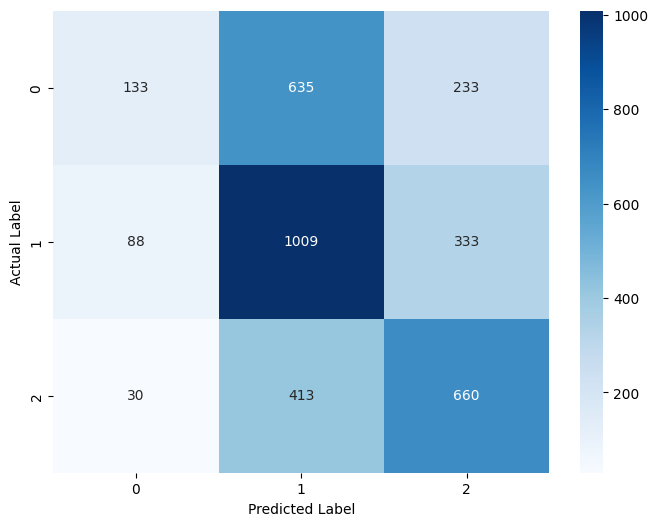

Training BiLSTM model with multihead attention...
859/859 ━━━━━━━━━━━━━━━━━━━━ 26s 26ms/step - accuracy: 0.5770 - loss: 0.9123 - val_accuracy: 0.4652 - val_loss: 1.7079 - learning_rate: 0.0010
859/859 ━━━━━━━━━━━━━━━━━━━━ 21s 25ms/step - accuracy: 0.7240 - loss: 0.6827 - val_accuracy: 0.4833 - val_loss: 1.2820
111/111 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
              precision    recall  f1-score   support

           0       0.58      0.10      0.16      1001
           1       0.44      0.91      0.60      1430
           2       0.70      0.28      0.40      1103

    accuracy                           0.48      3534
   macro avg       0.57      0.43      0.39      3534
weighted avg       0.56      0.48      0.41      3534



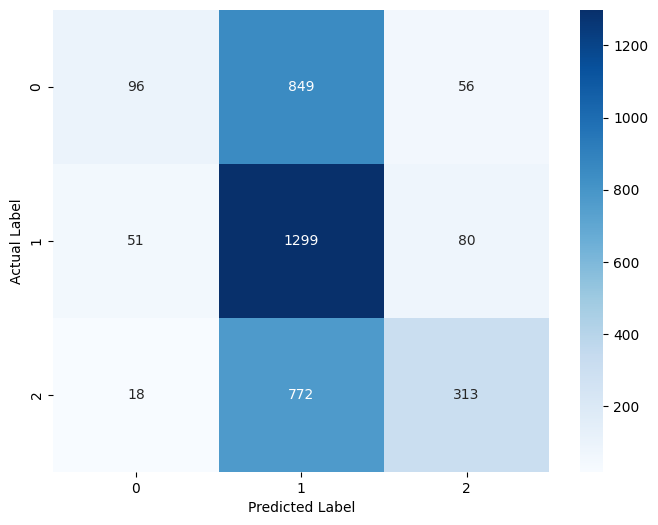

Training BiLSTM model with self attention...
859/859 ━━━━━━━━━━━━━━━━━━━━ 28s 26ms/step - accuracy: 0.5848 - loss: 0.8957 - val_accuracy: 0.4587 - val_loss: 1.5140 - learning_rate: 0.0010
859/859 ━━━━━━━━━━━━━━━━━━━━ 22s 25ms/step - accuracy: 0.7250 - loss: 0.6727 - val_accuracy: 0.4969 - val_loss: 1.4960
111/111 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
              precision    recall  f1-score   support

           0       0.51      0.18      0.26      1001
           1       0.45      0.83      0.59      1430
           2       0.69      0.35      0.46      1103

    accuracy                           0.50      3534
   macro avg       0.55      0.45      0.44      3534
weighted avg       0.54      0.50      0.46      3534



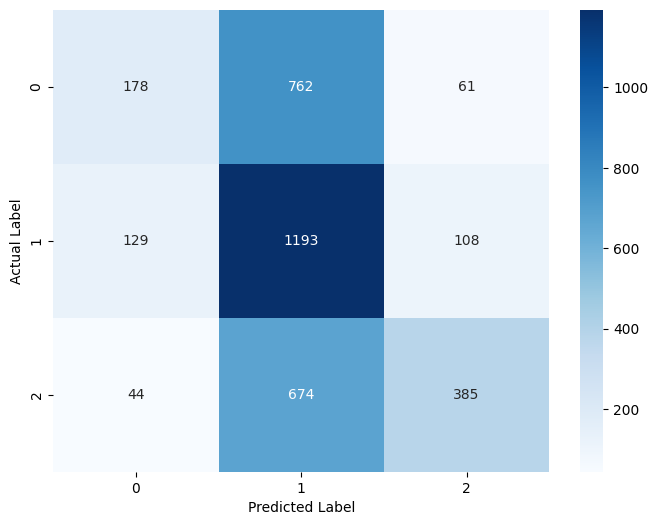

Training BiLSTM model with adaptive attention...
859/859 ━━━━━━━━━━━━━━━━━━━━ 27s 26ms/step - accuracy: 0.5704 - loss: 0.9150 - val_accuracy: 0.4038 - val_loss: 2.6466 - learning_rate: 0.0010
859/859 ━━━━━━━━━━━━━━━━━━━━ 22s 25ms/step - accuracy: 0.7308 - loss: 0.6697 - val_accuracy: 0.3107 - val_loss: 3.3768
111/111 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
              precision    recall  f1-score   support

           0       0.29      0.99      0.45      1001
           1       0.00      0.00      0.00      1430
           2       0.74      0.10      0.17      1103

    accuracy                           0.31      3534
   macro avg       0.35      0.36      0.21      3534
weighted avg       0.32      0.31      0.18      3534



/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



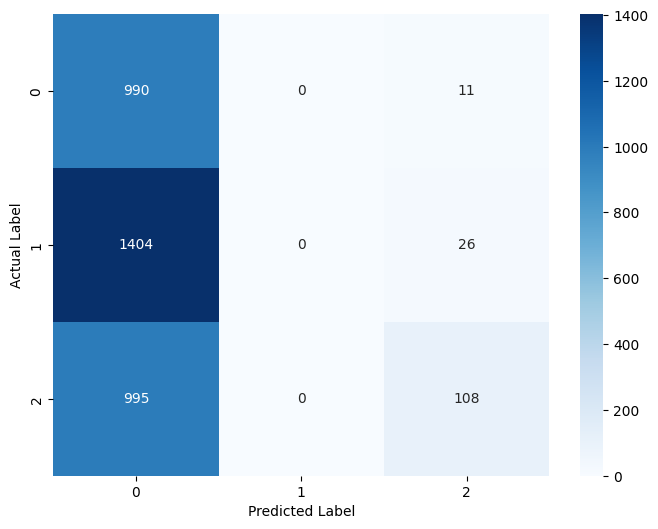

Training GRU model without attention...
859/859 ━━━━━━━━━━━━━━━━━━━━ 17s 17ms/step - accuracy: 0.5698 - loss: 0.9279 - val_accuracy: 0.5170 - val_loss: 1.1930 - learning_rate: 0.0010
712/859 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - accuracy: 0.7281 - loss: 0.6711

In [ ]:
model_types = ['RNN', 'LSTM', 'BiLSTM', 'GRU', 'BiGRU']
attention_types = [None, 'multihead', 'self', 'adaptive']
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
lr_reduction = ReduceLROnPlateau(monitor='val_loss', patience=3, factor=0.5, min_lr=0.00001)
for model_type in model_types:
    for attention_type in attention_types:
        if attention_type:
            print(f"Training {model_type} model with {attention_type} attention...")
        else:
            print(f"Training {model_type} model without attention...")
        model = create_model(model_type, vocab_size, embedding_dim, num_classes)
        history=model.fit(X, y, epochs=1, validation_data=(X_test_data, y_test_data), callbacks=[early_stopping, lr_reduction])
        history= model.fit(X, y, epochs=1, validation_data=(X_test_data, y_test_data))
        y_pred = model.predict(X_test_data)
        y_pred_class = np.argmax(y_pred, axis=1)
        y_true_class = np.argmax(y_test_data, axis=1)
        print(classification_report(y_true_class, y_pred_class))
        conf_matrix = confusion_matrix(y_true_class, y_pred_class)
        # Visualize the confusion matrix

        plt.figure(figsize=(8, 6))

        sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues")

        plt.ylabel('Actual Label')

        plt.xlabel('Predicted Label')

        plt.show()